# Image Processing and Analysis

In [1]:
"""
Nguyễn Quang Trường
21110429
Dip lab 08
"""

'\nNguyễn Quang Trường\n21110429\nDip lab 08\n'

In [2]:
import numpy as np 
import pandas as pd
import cv2 
from matplotlib import pyplot as plt 
import matplotlib.cm as cm
import matplotlib.gridspec as gridspec
from pylab import imread
from skimage.color import rgb2gray

In [3]:
def ShowImage(ImageList, nRows = 1, nCols = 2, WidthSpace = 0.00, HeightSpace = 0.00):
    from matplotlib import pyplot as plt 
    import matplotlib.gridspec as gridspec
    
    gs = gridspec.GridSpec(nRows, nCols)     
    gs.update(wspace=WidthSpace, hspace=HeightSpace) # set the spacing between axes.
    plt.figure(figsize=(20,10))
    for i in range(len(ImageList)):
        ax1 = plt.subplot(gs[i])
        ax1.set_xticklabels([])
        ax1.set_yticklabels([])
        ax1.set_aspect('equal')

        plt.subplot(nRows, nCols,i+1)

        image = ImageList[i].copy()
        if (len(image.shape) < 3):
            plt.imshow(image, plt.cm.gray)
        else:
            plt.imshow(image)
        plt.title("Image " + str(i))
        plt.axis('off')

    plt.show()

In [4]:
def InfoImage(IM):
    Image = IM
    Width = Image.shape[1]
    Height = Image.shape[0]
    Channel = len(Image.shape)
    print("Width : ", Width, " Height : ", Height, " Channel : ", Channel)
    
    if(Channel == 2):
        print("Min Intensity: ", IM.min(), " Max Intensity: ", IM.max())
    else:
        print("Red - Min Intensity: ", IM[:,:,0].min(), " Max Intensity: ", IM[:,:,0].max())
        print("Green - Min Intensity: ", IM[:,:,1].min(), " Max Intensity: ", IM[:,:,1].max())
        print("Blue - Min Intensity: ", IM[:,:,2].min(), " Max Intensity: ", IM[:,:,2].max()) 

In [5]:
def ResizeImage(IM, DesiredWidth, DesiredHeight):
    from skimage.transform import rescale, resize
    
    OrigWidth = float(IM.shape[1])
    OrigHeight = float(IM.shape[0])
    Width = DesiredWidth 
    Height = DesiredHeight

    if((Width == 0) & (Height == 0)):
        return IM
    
    if(Width == 0):
        Width = int((OrigWidth * Height)/OrigHeight)

    if(Height == 0):
        Height = int((OrigHeight * Width)/OrigWidth)

    dim = (Width, Height)
#     print(dim)
    resizedIM = cv2.resize(IM, dim, interpolation = cv2.INTER_NEAREST) 
#     imshows([IM, resizedIM], ["Image", "resizedIM"],1,2)
    return resizedIM

## Câu 1: Kiếm 1 ảnh từ internet thực hiện các thao tác biến đổi 

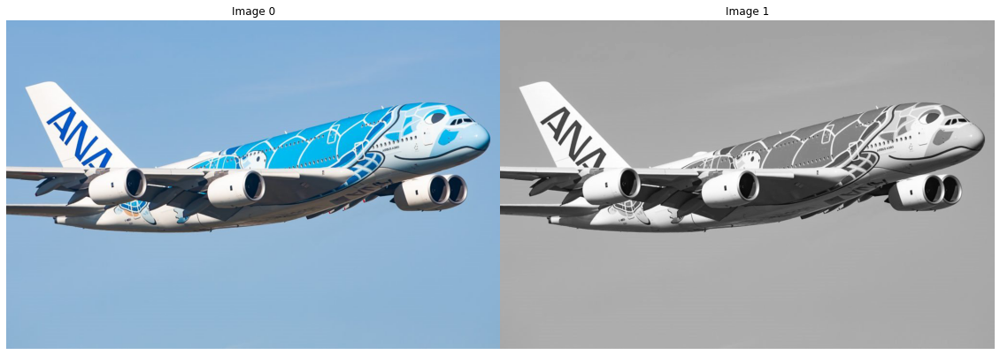

In [6]:
# Read Image 
image_color = imread("Maybay.jpg")
# Convert Image into Gray
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

# Display Image
ShowImage([image_color, image_gray], 1, 2)

###  Scaling

Dùng hàm resize trong thư viện opencv để Scaling ảnh


 image_color :
Width :  1024  Height :  683  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  5  Max Intensity:  255
Blue - Min Intensity:  19  Max Intensity:  255

 image_scale01 :
Width :  512  Height :  683  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  5  Max Intensity:  255
Blue - Min Intensity:  18  Max Intensity:  255

 image_scale02 :
Width :  512  Height :  342  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  4  Max Intensity:  255
Blue - Min Intensity:  13  Max Intensity:  255

 image_scale03 :
Width :  1024  Height :  342  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  2  Max Intensity:  255
Blue - Min Intensity:  18  Max Intensity:  255


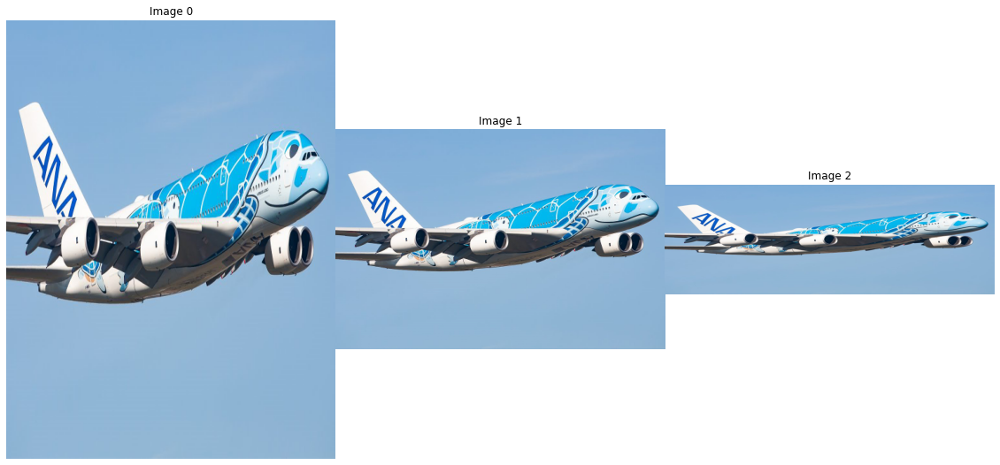

In [7]:
# Scaling
image_scale01 = cv2.resize(image_color,None,fx=0.5, fy=1, interpolation = cv2.INTER_CUBIC)
image_scale02 = cv2.resize(image_color,None,fx=0.5, fy=0.5, interpolation = cv2.INTER_CUBIC)
image_scale03 = cv2.resize(image_color,None,fx=1, fy=0.5, interpolation = cv2.INTER_CUBIC)

print("\n image_color :")
InfoImage(image_color)
print("\n image_scale01 :")
InfoImage(image_scale01)
print("\n image_scale02 :")
InfoImage(image_scale02)
print("\n image_scale03 :")
InfoImage(image_scale03)

ShowImage([image_scale01, image_scale02, image_scale03], 1, 3)

### Translation

Tải thư viện imutils

In [8]:
!pip install imutils

Dùng translate trong thư viện imitils để translation ảnh

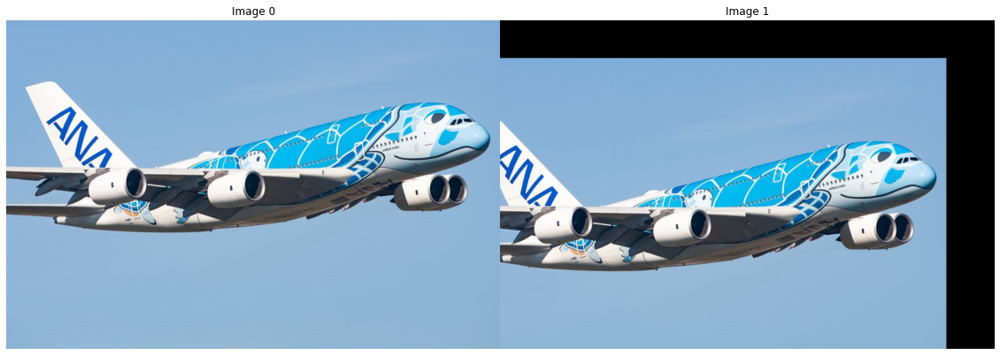

In [9]:
import imutils

tx= -100
ty= 80
translated_image = imutils.translate(image_color, tx, ty)
ShowImage([image_color,translated_image],1,2)

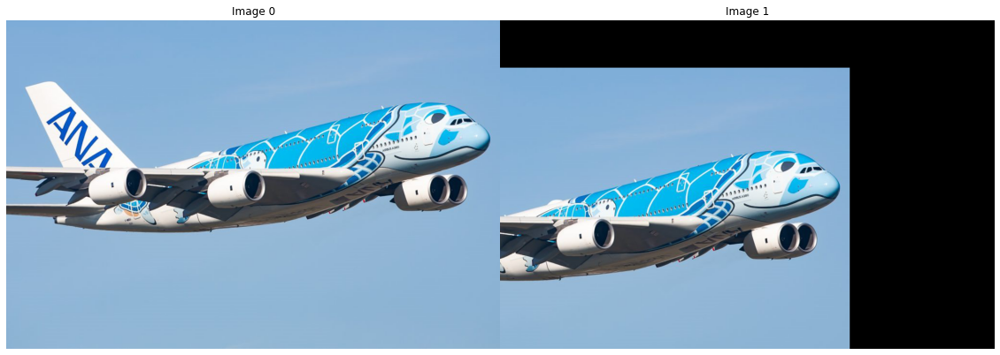

In [10]:
tx= -300
ty= 100
translated_image = imutils.translate(image_color, tx, ty)
ShowImage([image_color,translated_image],1,2)

###  Rotation (30, 45, 60, 90, 120, 160, 180)

Dùng rotate trong imitils để thực hiện Rotation ảnh

hàm imutils.rotate_bound được sử dụng để xoay hình ảnh với góc xoay bất kỳ mà không làm mất thông tin ảnh

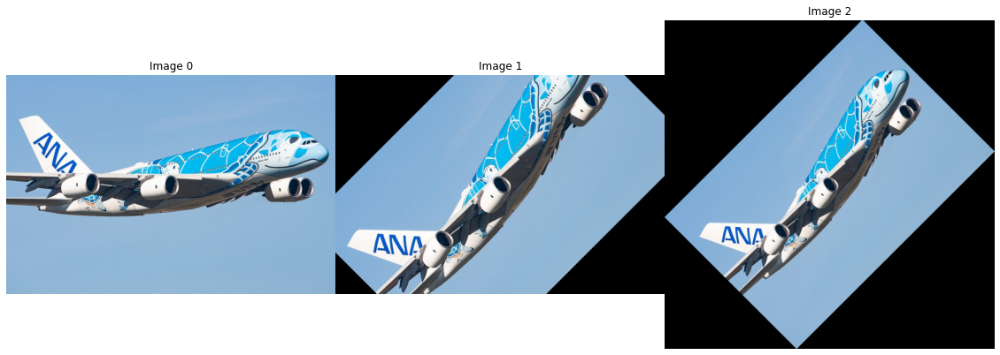

In [12]:
import imutils

image_rotated45 = imutils.rotate(image_color, 45)
image_rotated45_bound = imutils.rotate_bound(image_color, -45)

ShowImage([image_color, image_rotated45, image_rotated45_bound], 1, 3)

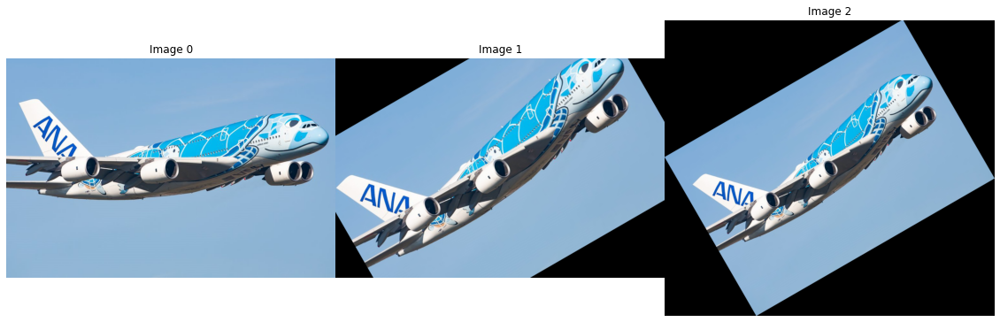

In [13]:
image_rotated = imutils.rotate(image_color, 30)
image_rotated_bound = imutils.rotate_bound(image_color, -30)

ShowImage([image_color, image_rotated, image_rotated_bound], 1, 3)

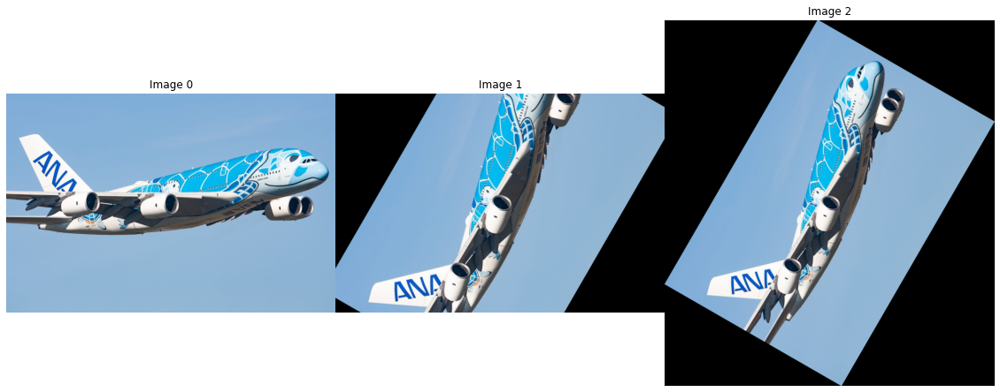

In [14]:
image_rotated = imutils.rotate(image_color, 60)
image_rotated_bound = imutils.rotate_bound(image_color, -60)

ShowImage([image_color, image_rotated, image_rotated_bound], 1, 3)

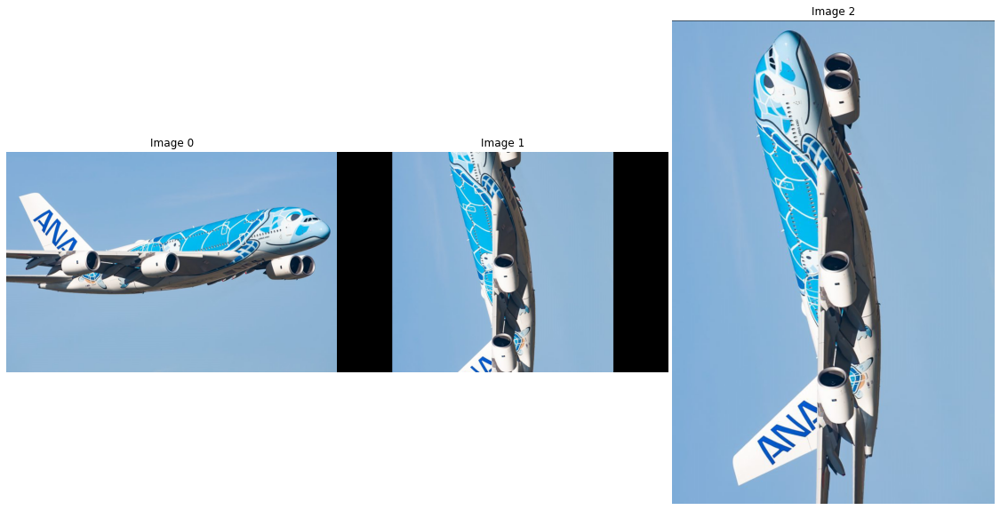

In [15]:
image_rotated = imutils.rotate(image_color, 90)
image_rotated_bound = imutils.rotate_bound(image_color, -90)

ShowImage([image_color, image_rotated, image_rotated_bound], 1, 3)

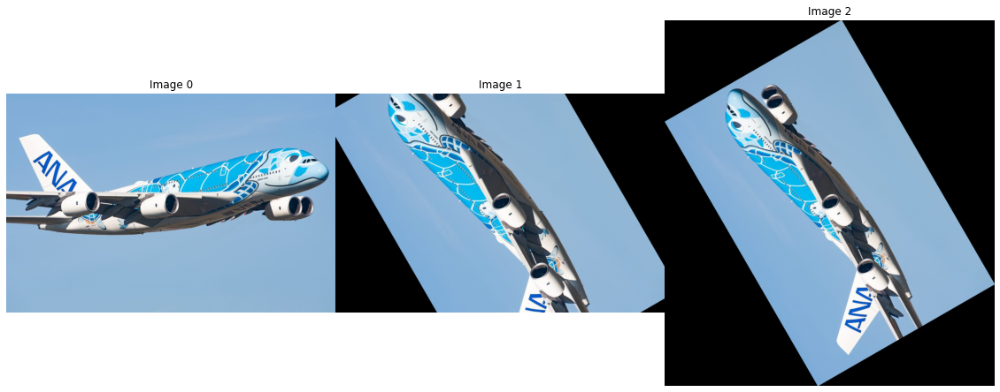

In [16]:
image_rotated = imutils.rotate(image_color, 120)
image_rotated_bound = imutils.rotate_bound(image_color, -120)

ShowImage([image_color, image_rotated, image_rotated_bound], 1, 3)

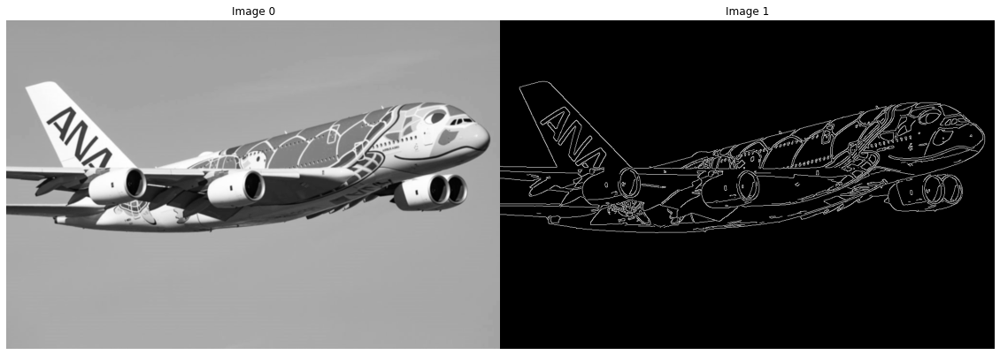

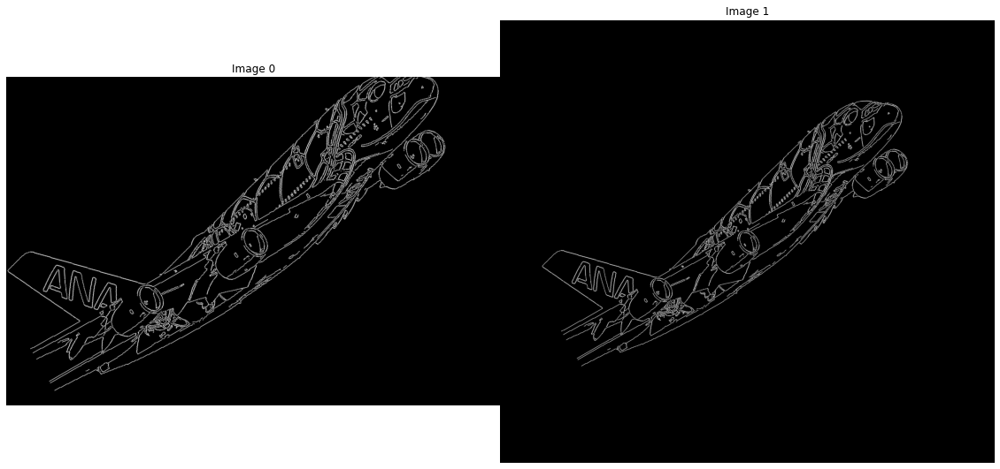

In [17]:
image_gray_blur = cv2.GaussianBlur(image_gray, (3, 3), 0)
image_edged = cv2.Canny(image_gray_blur, 50, 100)

image_edged_rotated45 = imutils.rotate(image_edged, 30)
image_edged_rotated45_bound = imutils.rotate_bound(image_edged, -30)

ShowImage([image_gray_blur, image_edged], 1, 2)
ShowImage([image_edged_rotated45, image_edged_rotated45_bound], 1, 2)

### Shearing

Dùng trasform của  skimage để thực hiện shearing ảnh

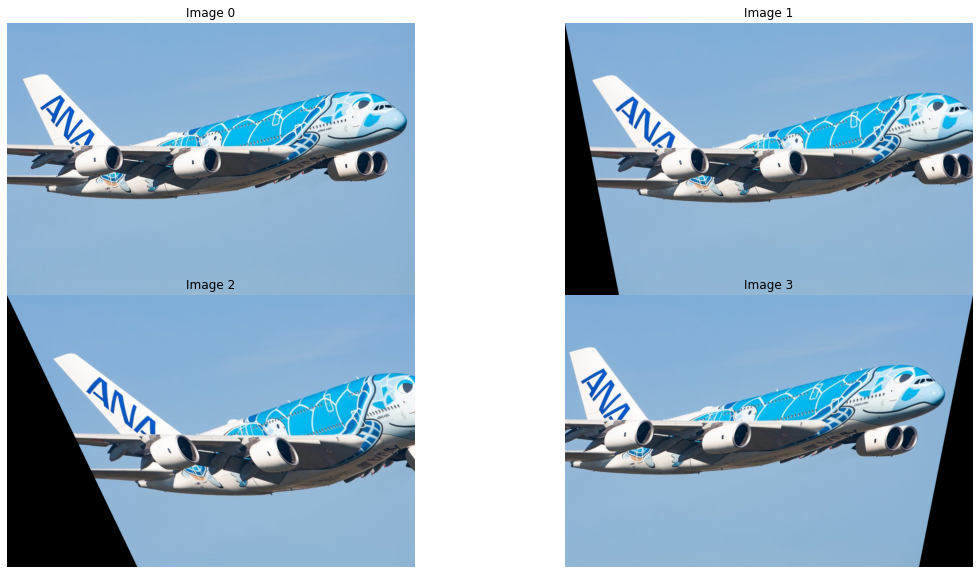

In [18]:
from skimage import transform as tf

# Create Afine transform
afine_tf = tf.AffineTransform(shear=0.2)
image_shear01 = tf.warp(image_color, inverse_map=afine_tf)

afine_tf = tf.AffineTransform(shear=0.5)
image_shear02 = tf.warp(image_color, inverse_map=afine_tf)

afine_tf = tf.AffineTransform(shear=-0.2)
image_shear03 = tf.warp(image_color, inverse_map=afine_tf)

ShowImage([image_color, image_shear01, image_shear02, image_shear03], 2, 2)

## Câu 2: Kiếm 1 ảnh từ internet thực hiện các thao tác biến đổi sau bằng cách nhân thông qua ma trận biến đổi  

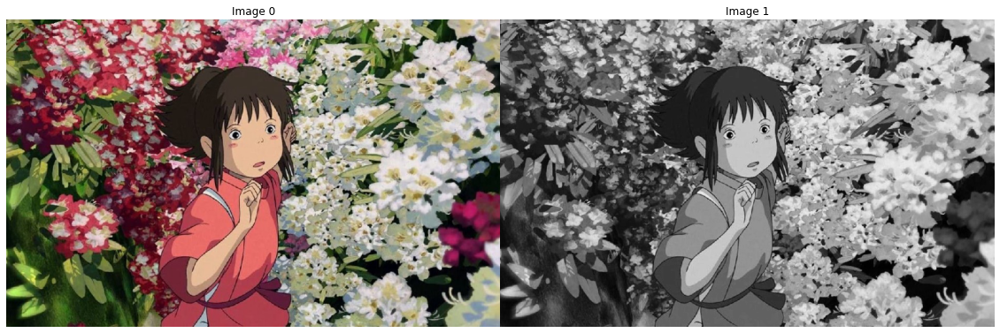

In [36]:
# Read Image 
image_color = imread("Anime.jpg")
# Convert Image into Gray
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

# Display Image
ShowImage([image_color, image_gray], 1, 2)

### Scaling

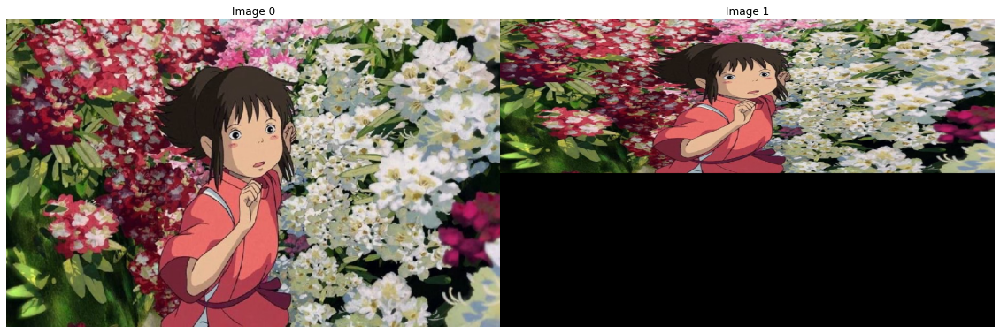

In [37]:
scale_factor_x, scale_factor_y = 1, 0.5

#matrix sacling
scaling_matrix = np.float32([[scale_factor_x, 0, 0], [0, scale_factor_y, 0]])


scaled_img = cv2.warpAffine(image_color, scaling_matrix, (image_color.shape[1], image_color.shape[0]))
ShowImage([image_color, scaled_img], 1, 2)

### Rotation (30, 45, 60, 90, 120, 160, 180)

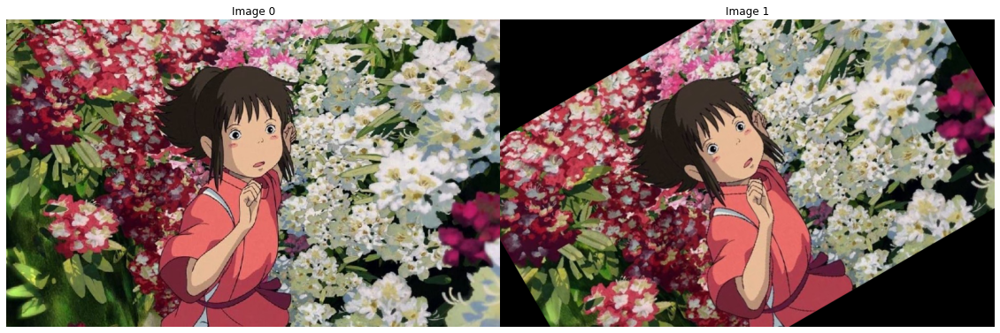

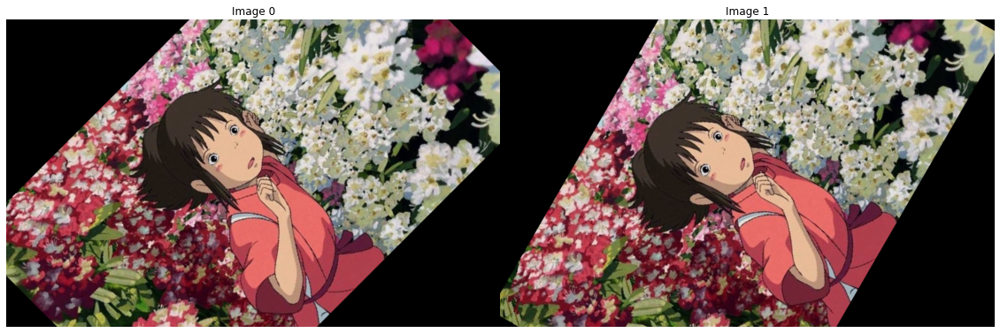

In [38]:
rows,cols  = image_color.shape[:2]

#Rotation Matrix 30
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),30,1)
image_rotation01 = cv2.warpAffine(image_color,RotationMatrix,(cols,rows))

#Rotation Matrix 45
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),45,1)
image_rotation02 = cv2.warpAffine(image_color,RotationMatrix,(cols,rows))


#Rotation Matrix 60
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),60,1)
image_rotation03 = cv2.warpAffine(image_color,RotationMatrix,(cols,rows))


ShowImage([image_color, image_rotation01], 1, 2)
ShowImage([image_rotation02, image_rotation03], 1, 2)

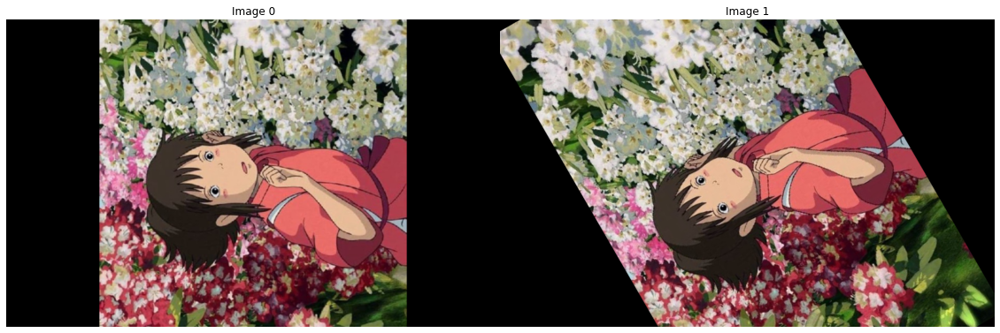

In [39]:
#Rotation Matrix 90
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),90,1)
image_rotation05 = cv2.warpAffine(image_color,RotationMatrix,(cols,rows))

#Rotation Matrix 120
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),120,1)
image_rotation06 = cv2.warpAffine(image_color,RotationMatrix,(cols,rows))

ShowImage([image_rotation05, image_rotation06], 1, 2)

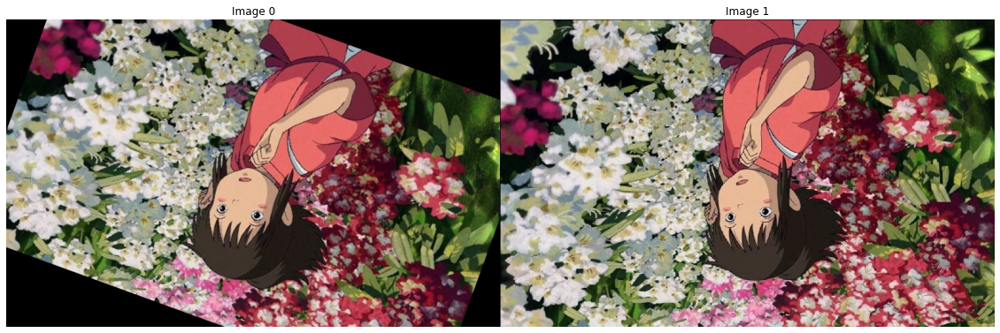

In [40]:
#Rotation Matrix 160
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),160,1)
image_rotation07 = cv2.warpAffine(image_color,RotationMatrix,(cols,rows))

#Rotation Matrix 180
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),180,1)
image_rotation08 = cv2.warpAffine(image_color,RotationMatrix,(cols,rows))

ShowImage([image_rotation07, image_rotation08], 1, 2)

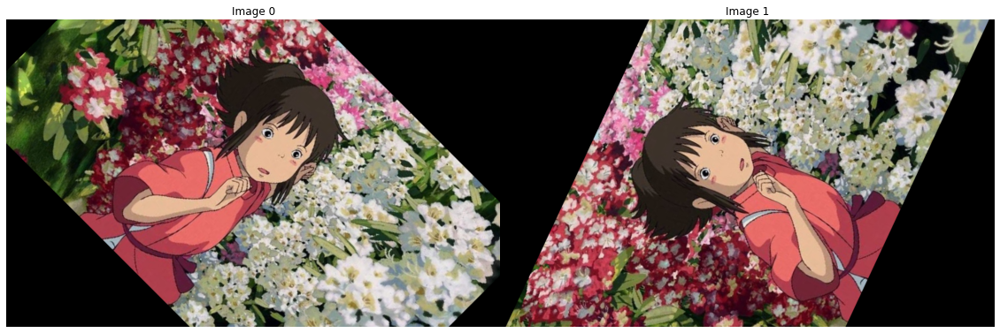

In [41]:
#Rotation Matrix -45
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),-45,1)
image_rotation09 = cv2.warpAffine(image_color,RotationMatrix,(cols,rows))

#Rotation Matrix 65
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),65,1)
image_rotation10 = cv2.warpAffine(image_color,RotationMatrix,(cols,rows))

ShowImage([image_rotation09, image_rotation10], 1, 2)

### Shearing

Matrix : 


array([[ 0.89333333,  0.22666667, 10.        ],
       [-0.10666667,  1.22666667, 10.        ]])

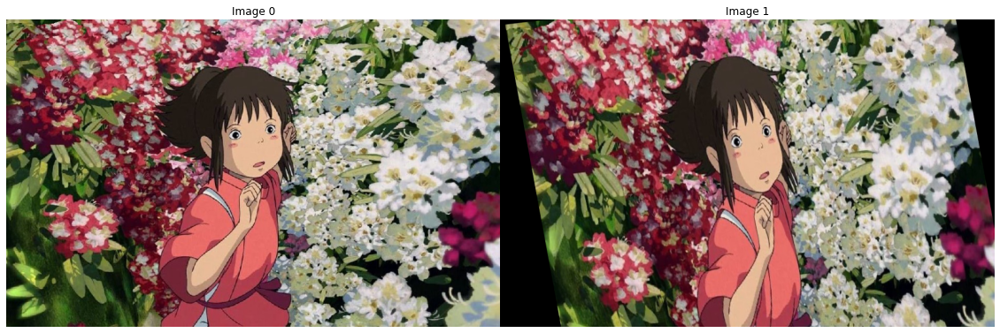

In [42]:
rows,cols  = image_color.shape[:2]

PointList_From = [[0,0],[200,50],[50,200]]
PointList_To = [[10,10],[200,50],[100,250]]

pts1 = np.float32(PointList_From)
pts2 = np.float32(PointList_To)

#Mapping Matrix for Shearing 
MappingMatrix = cv2.getAffineTransform(pts1,pts2)
image_Affine = cv2.warpAffine(image_color,MappingMatrix,(cols,rows))

print("Matrix : ")
display(MappingMatrix)
ShowImage([image_color, image_Affine], 1, 2)

### Translation

In [26]:
rows,cols  = image_color.shape[:2]


#Translation Matrix 
TranslationMatrix = np.float32([[1,0,200],[0,1,0]])
image_translation01 = cv2.warpAffine(image_color,TranslationMatrix,(cols,rows))

#Translation Matrix 
TranslationMatrix = np.float32([[1,0,0],[0,1,200]])
image_translation02 = cv2.warpAffine(image_color,TranslationMatrix,(cols,rows))


#Translation Matrix
TranslationMatrix = np.float32([[1,0,200],[0,1,200]])
image_translation03 = cv2.warpAffine(image_color,TranslationMatrix,(cols,rows))

TranslationMatrix = np.float32([[1,0,-200],[0,1,-200]])
image_translation04 = cv2.warpAffine(image_color,TranslationMatrix,(cols,rows))

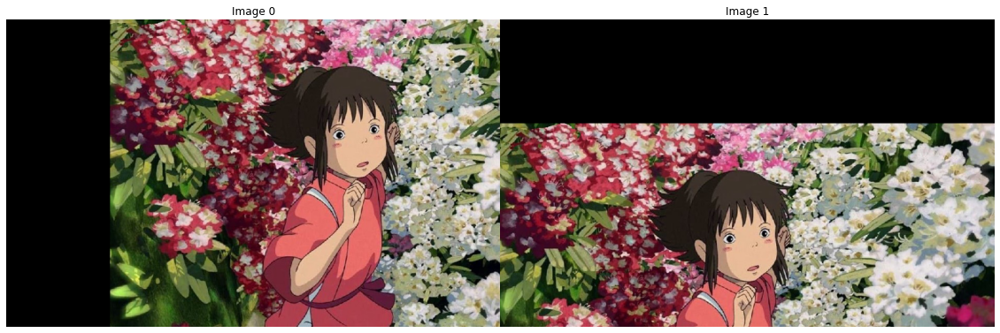

In [27]:
ShowImage([image_translation01, image_translation02], 1, 2)

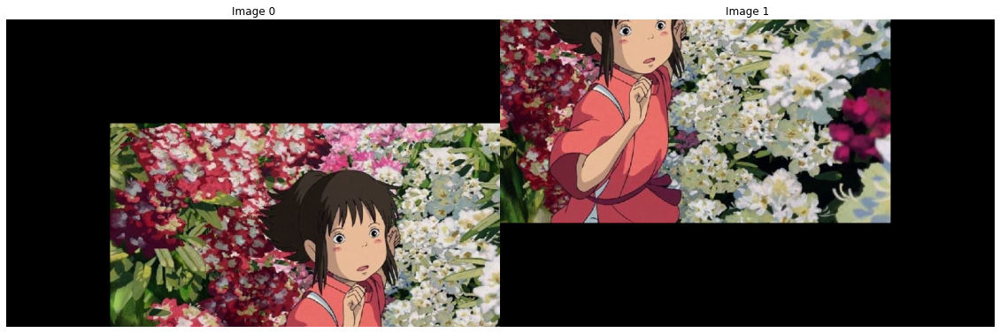

In [28]:
ShowImage([image_translation03, image_translation04], 1, 2)

## Câu 3

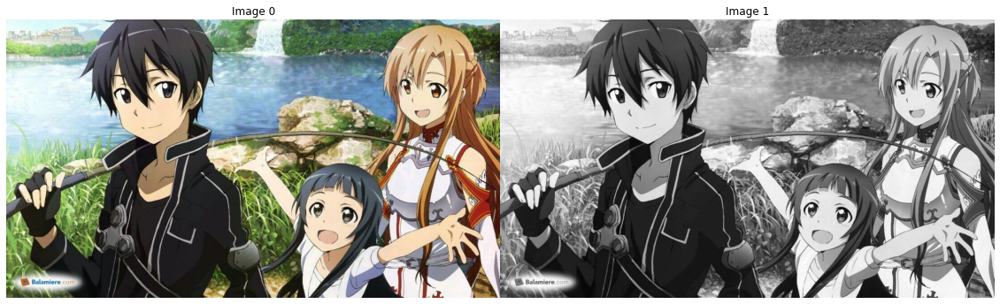

In [29]:
# Read Image 
image_color = imread("Anime2.jpg")
# Convert Image into Gray
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

# Display Image
ShowImage([image_color, image_gray], 1, 2)

### Scaling → Rotation:

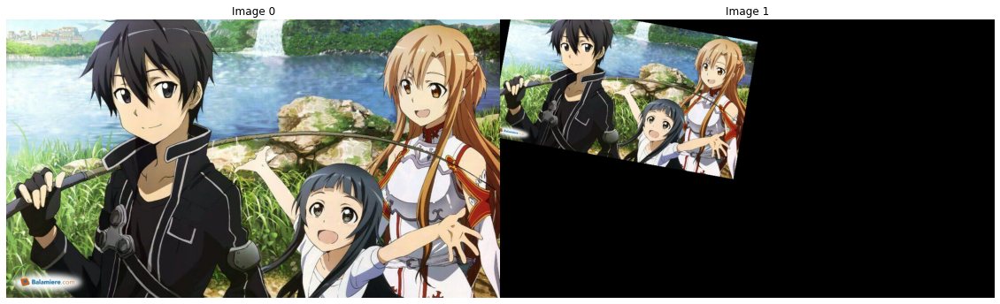

In [30]:
scale_factor_x, scale_factor_y = 0.5, 0.5
scaling_matrix = np.float32([[scale_factor_x, 0, 0], [0, scale_factor_y, 0]])

rows,cols  = image_color.shape[:2]
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),-10,1)

#Matrix for Scaling → Rotation
Matrix_ScaRota=np.dot(scaling_matrix[:,:2],RotationMatrix)

image_Affine = cv2.warpAffine(image_color,Matrix_ScaRota,(cols,rows))
ShowImage([image_color, image_Affine], 1, 2)

### 	Rotation → Shearing 

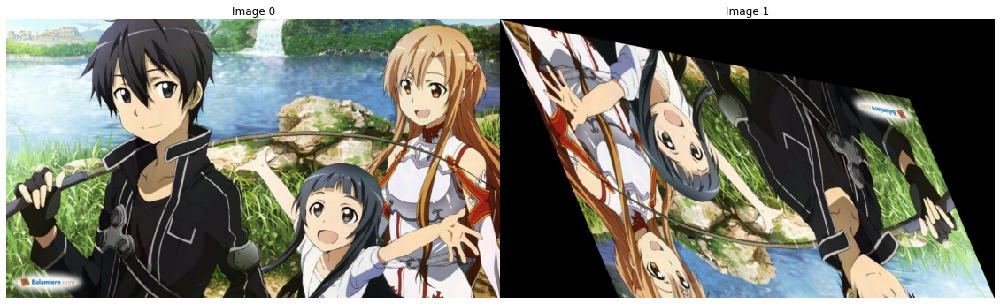

In [31]:
rows,cols  = image_color.shape[:2]
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),180,1)

rows,cols  = image_color.shape[:2]

PointList_From = [[0,0],[200,50],[50,200]]
PointList_To = [[10,10],[200,100],[150,250]]

pts1 = np.float32(PointList_From)
pts2 = np.float32(PointList_To)

MappingMatrix = cv2.getAffineTransform(pts1,pts2)


# Maxtrix for Rotation-> Shearing
Matrix_RotaShea=np.dot(MappingMatrix[:,:2],RotationMatrix)

image_Affine = cv2.warpAffine(image_color,Matrix_RotaShea,(cols,rows))

ShowImage([image_color, image_Affine], 1, 2)

### 	Scaling → Rotation → Shearing

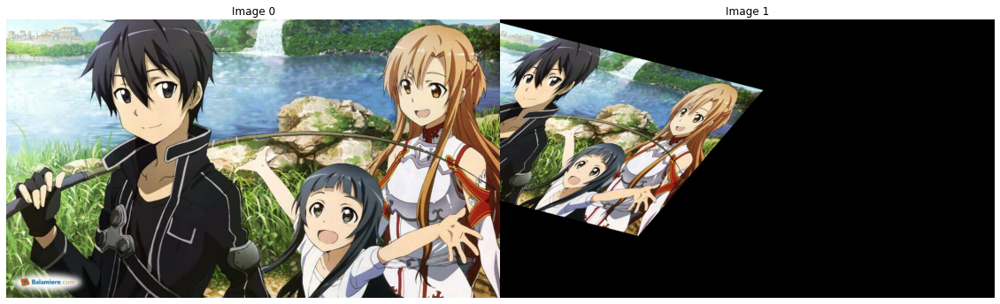

In [32]:
rows,cols  = image_color.shape[:2]

scale_factor_x, scale_factor_y =0.5, 0.5
scaling_matrix = np.float32([[scale_factor_x, 0, 0], [0, scale_factor_y, 0]])


RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),-50,1)

Matrix_ScaRota=np.dot(scaling_matrix[:,:2],RotationMatrix)

PointList_From = [[0,0],[200,50],[50,200]]
PointList_To =[[10,10],[200,-50],[100,250]]

pts1 = np.float32(PointList_From)
pts2 = np.float32(PointList_To)

MappingMatrix = cv2.getAffineTransform(pts1,pts2)


# Maxtrix for Scaling → Rotation → Shearing
Matrix_ScaRoShe=np.dot(Matrix_ScaRota[:,:2],MappingMatrix)

image_Affine = cv2.warpAffine(image_color,Matrix_ScaRoShe,(cols,rows))
ShowImage([image_color, image_Affine], 1, 2)

## Câu 4 	Dùng biến đổi Affine hoặc Perspective để canh chỉnh ảnh thẳng lại

Width :  900  Height :  500  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  0  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255


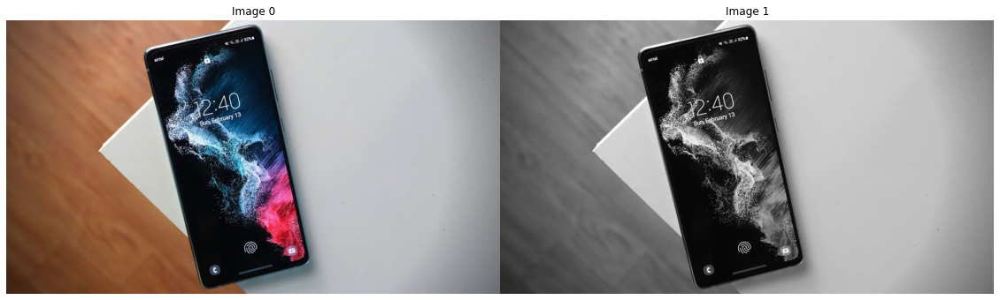

In [33]:
# Read Image 
image_color = imread("DienThoai.jpg")
# Convert Image into Gray
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

# Display Image
InfoImage(image_color)
ShowImage([image_color, image_gray], 1, 2)

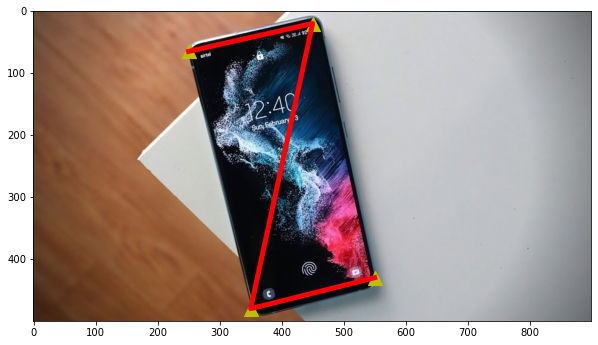

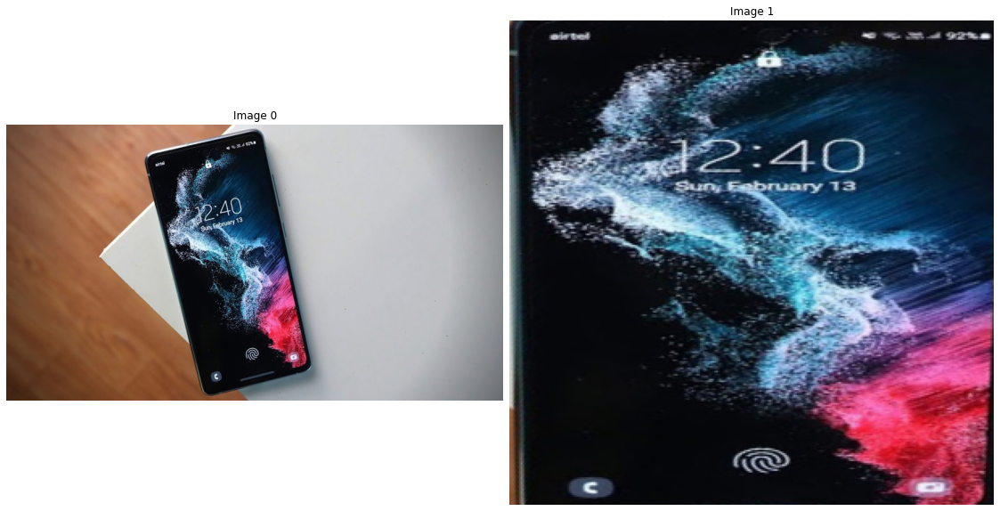

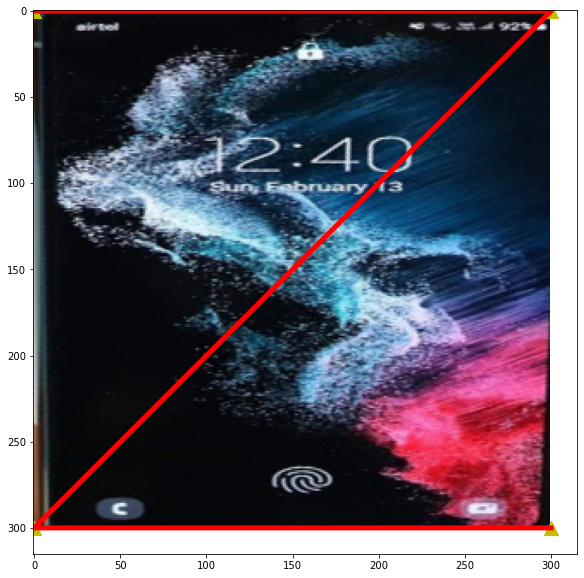

In [34]:
rows,cols,ch = image_color.shape

PointList_From = [[250,65],[450,20],[350,480],[550,430]]
PointList_To = [[0,0],[300,0],[0,300],[300,300]]

XList = []
YList = []

for pt in PointList_From:
    XList.append(pt[0])
    YList.append(pt[1])
    
plt.figure(figsize=(10,10))
plt.imshow(image_color)

plt.scatter(XList, YList, c='y', s=200, marker='^')
plt.plot(XList,YList,'r', linewidth=5, markersize=12)

plt.show()


pts1 = np.float32(PointList_From)
pts2 = np.float32(PointList_To)
MappingMatrix = cv2.getPerspectiveTransform(pts1,pts2)
image_Perspective = cv2.warpPerspective(image_color,MappingMatrix,(300,300))
ShowImage([image_color, image_Perspective], 1, 2)

XList = []
YList = []

for pt in PointList_To:
    XList.append(pt[0])
    YList.append(pt[1])
    
plt.figure(figsize=(10,10))
plt.imshow(image_Perspective)

plt.scatter(XList, YList, c='y', s=200, marker='^')
plt.plot(XList,YList,'r', linewidth=5, markersize=12)

plt.show()

## Thêm

### Perspective Transformation

Width :  1280  Height :  720  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  0  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255


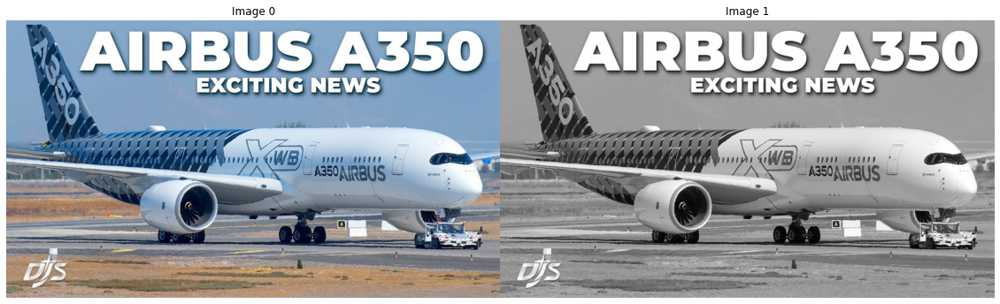

In [74]:
# Read Image 
image_color = imread("Airbus350.jpg")
# Convert Image into Gray
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

# Display Image
InfoImage(image_color)
ShowImage([image_color, image_gray], 1, 2)

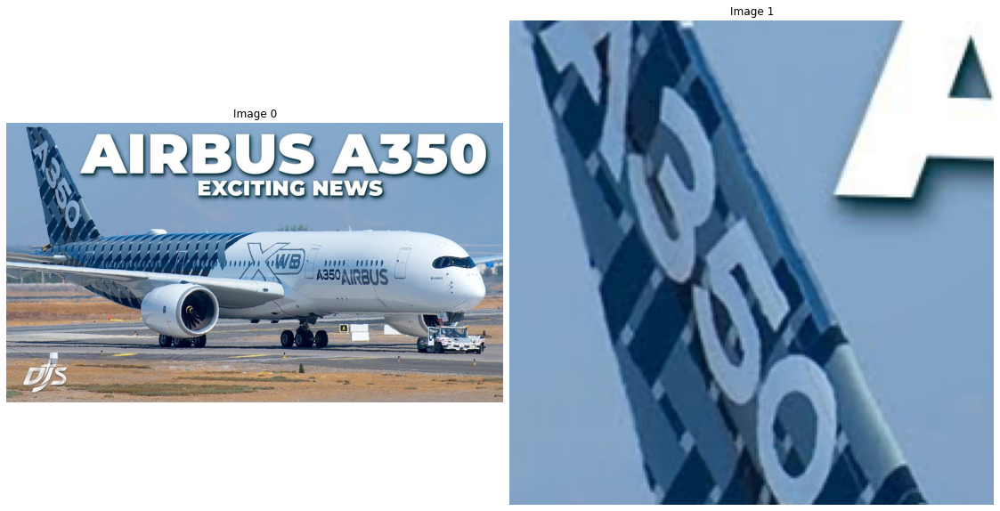

In [76]:
pts1 = np.float32([[56,65],[368,52],[28,387],[389,390]]) 
pts2 = np.float32([[0,0],[300,0],[0,300],[300,300]])      
M = cv2.getPerspectiveTransform(pts1, pts2)
warped_img = cv2.warpPerspective(image_color, M, (200,200))  # Adjust output image size as needed


ShowImage([image_color,warped_img],1,2)

### Elastic Transformation

Width :  3093  Height :  1740  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  0  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255


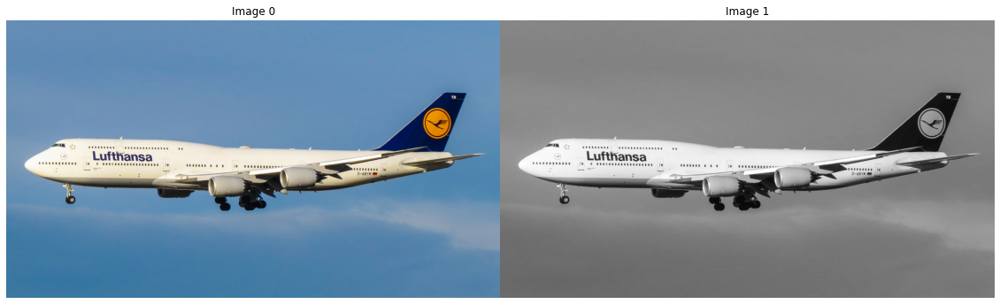

In [64]:
# Read Image 
image_color = imread("Boing747.jpg")
# Convert Image into Gray
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

# Display Image
InfoImage(image_color)
ShowImage([image_color, image_gray], 1, 2)

In [59]:
! pip install elasticdeform

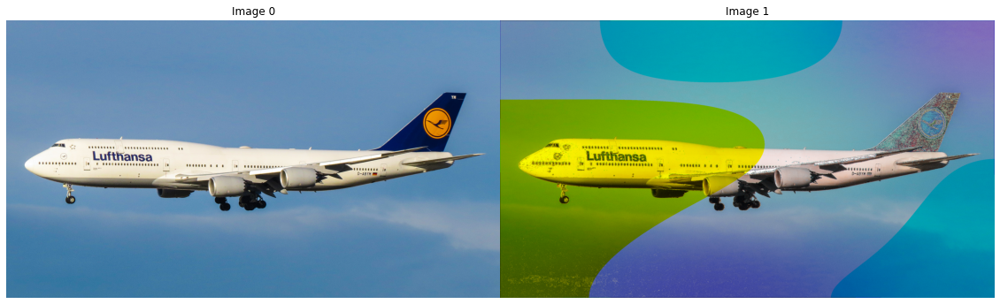

In [65]:
import numpy as np
import matplotlib.pyplot as plt
import elasticdeform


# Chuyển hình ảnh sang mảng numpy
image_array = np.array(image_color)

# Tạo một trường vector điều khiển ngẫu nhiên
random_field = np.random.rand(*image_array.shape) * 50 - 25

# Áp dụng Elastic Deformation
deformed_image = elasticdeform.deform_random_grid(image_array, sigma=0.3, points=3)

# Hiển thị hình ảnh gốc và hình ảnh sau biến đổi
ShowImage([image_color,deformed_image],1,2)